# Домашнее задание №2

Задание присылать на почту **aleksartmonov@gmail.com** в форматах *.ipynb* и отрендеренный результат в *.html*

В теме письма указать **HSE2018 HW2 <Фамилия Имя>**

soft deadline: 09.02.2018T23:59:00+0300

hard deadline: 16.02.2018T23:59:00+0300

In [2]:
from google.colab import drive
drive.mount('/content/gdrive')
!cp /content/gdrive/My\ Drive/tmp/hw2 -r ./
%cd hw2

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=email%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdocs.test%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive.photos.readonly%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/gdrive
/content/hw2


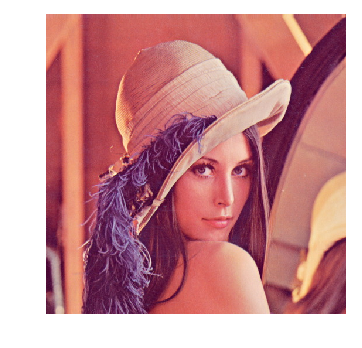

In [3]:
import cv2
import numpy as np
import ipywidgets as wg
import matplotlib.pylab as plt
%matplotlib inline
plt.style.use('default')

def show_bgr(img, size=3):
    plt.figure(figsize=(size,size))
    ax = plt.axes([0,0,1,1], frameon=False)
    ax.set_axis_off()
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))

lena = cv2.imread("lena.jpg")
show_bgr(lena)
h, w, k = lena.shape

**1. (6 баллов)** С помощью [виджетов](http://ipywidgets.readthedocs.io/en/latest/examples/Widget%20List.html) создайте 2 слайдера с настройками параметров гамма-коррекции. Отобразите **lena**, ее гамма-преобразование и график в диапозоне от [0;1], так, чтобы параметры слайдера соответствовали параметрам гамма-коррекции. 

In [4]:
def gamma_correction(img, c=1, gamma=1):
    x = np.asarray([i / 255. for i in range(256)])
    y = np.asarray([min(c * (x[i] ** gamma) * 255, 255) for i in range(256)])
    plt.plot(x, y / 255);
    return cv2.LUT(img, y).astype(np.uint8)

wg.interact(lambda c, gamma: show_bgr(gamma_correction(lena, c, gamma)), 
            c=wg.FloatSlider(value=1, min=0, max=3, step=0.05, continuous_update=False), 
            gamma=wg.FloatSlider(value=1, min=0, max=5, step=0.05, continuous_update=False));

interactive(children=(FloatSlider(value=1.0, continuous_update=False, description='c', max=3.0, step=0.05), Fl…

**2. (5 баллов)** Загрузите изображение $lena.jpg$. Переведите изображение в градации серого. Примените к серому изображению операцию линейного растяжения диапазона яркостей ($normalize$) и эквализации гистограммы ($equalizeHist$). Постройте разность полученных результатов. Состыкуйте в одно изображение в градациях серого результат линейного растяжения, эквализации и их разности.

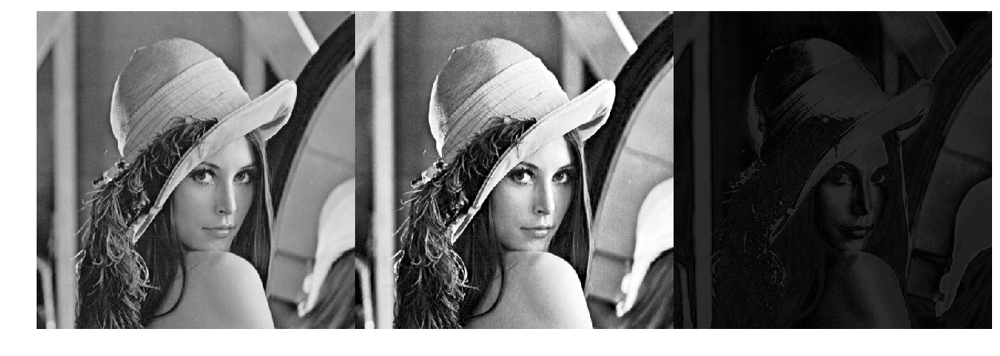

In [5]:
def show_gray(img, size=3):
    plt.figure(figsize=(size,size))
    ax = plt.axes([0,0,1,1], frameon=False)
    ax.set_axis_off()
    plt.imshow(img, cmap='gray')

lena_gray = cv2.cvtColor(lena, cv2.COLOR_BGR2GRAY)
lena_norm = cv2.normalize(lena_gray, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX)
lena_equal = cv2.equalizeHist(lena_gray, np.zeros_like(lena))
lena_diff = np.abs(lena_norm.astype(int) - lena_equal.astype(int)).astype(np.uint8)

res = np.concatenate((lena_norm, lena_equal), axis=1)
res = np.concatenate((res, lena_diff), axis=1)
show_gray(res, size=12)

**3. (5 баллов)** Реализуйте функцию добавления шума «соль и перец» для одноканального изображения. Входные параметры: $src$ – исходная одноканальная матрица $Mat$, $p$ – вероятность замещения исходных значений на $0$, $q$ – вероятность замещения исходных значений на $255$. Загрузите изображение $lena.jpg$, выделите каналы изображения в отдельные матрицы ($split$), добавьте шум «соль и перец» в каждый канал при помощи реализованной Вами функции с параметрами

1. $p=q=0.05$
2. $p=q=0.1$
3. $p=q=0.15$

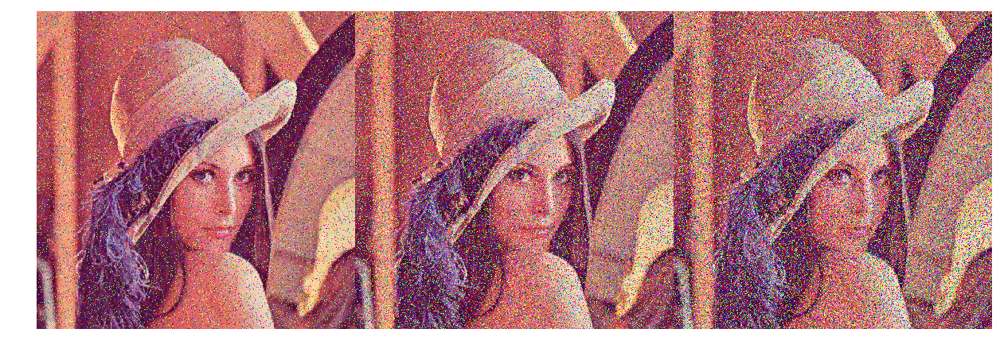

In [6]:
def salt_pepper(src, p, q):
    res = src.copy()
    hh, ww = src.shape
    for i in range(hh):
        for j in range(ww):
            t = np.random.uniform(0, 1)
            if (t <= p):
                res[i,j] = 0
            elif (t >= 1 - q):
                res[i,j] = 255
    return res.astype(np.uint8)

res1 = np.dstack(salt_pepper(img[:, :, 0], 0.05, 0.05) for img in np.dsplit(lena, 3))
res2 = np.dstack(salt_pepper(img[:, :, 0], 0.1, 0.1) for img in np.dsplit(lena, 3))
res3 = np.dstack(salt_pepper(img[:, :, 0], 0.15, 0.15) for img in np.dsplit(lena, 3))
res = np.concatenate((res1, res2), axis=1)
res = np.concatenate((res, res3), axis=1)
show_bgr(res, size=12)

**4. (5 баллов)** Удалите диагональные полоски с изображения $lena\_diagonal.jpg$. Вычислите среднеквадратичную ошибку (mean squared error, $MSE$) для полученного результата и изображения $lena\_gray\_512.tif$. Задача будет засчитана при $MSE < 1500$. Тот, у кого по результатам проверки будет наименьшее значение MSE среди всех студентов для этой задачи, получит призовую шоколадку (раньше мы раздавали призовые баллы, но теперь у нас концепция фиксированного максимального количества баллов)

In [7]:
def mse(img1, img2):
    return ((img1.astype(int) - img2.astype(int)) ** 2).mean()

lena_diag = cv2.imread("lena_diagonal.jpg")
lena_gray = cv2.imread('lena_gray_512.tif')
print(mse(lena_diag, lena_gray))

3484.66450881958


In [0]:
def fourier(img):
    return np.fft.fftshift(np.fft.fft2(img))


def inv_fourier(img):
    return np.abs(np.fft.ifft2(np.fft.ifftshift(img)))

lena_fourier = fourier(cv2.cvtColor(lena_diag, cv2.COLOR_BGR2GRAY))
hh, ww = lena_fourier.shape
lena_new = lena_fourier.copy()
for i in range(hh):
    for j in range(ww):
        if (i - hh/2) ** 2 + (j - ww/2) ** 2 > 5000:
            lena_new[i,j] = 0
lena_new = inv_fourier(lena_new)
err = mse(cv2.cvtColor(lena_gray, cv2.COLOR_BGR2GRAY), lena_new)
print(err)

904.6605339050293


**5. (5 баллов)** Подавите шум на изображении $lena\_color\_512\_noise.tif$. Вычислите среднеквадратичную ошибку ($MSE$) для полученного результата и изображения $lena\_color\_512.tif$. Задача будет засчитана при $MSE < 150$. Тот, у кого по результатам проверки будет наименьшее значение $MSE$ среди всех студентов для этой задачи, получит призовую шоколадку.

In [0]:
lena_noise = cv2.imread('lena_color_512-noise.tif')
lena_norm = cv2.imread('lena_color_512.tif')
print(mse(lena_noise, lena_norm))

2184.1810162862143


In [0]:
lena_new = cv2.fastNlMeansDenoisingColored(cv2.medianBlur(lena_noise, 5), None, 7, 7)
err = mse(lena_norm, lena_new)
print(err)

102.26254908243816


**6. (5 баллов)** Выделите в изображении $table.jpg$ границы таблицы с использованием морфологических операций. Результатом обработки должно быть изображение, в котором удален весь текст и оставлены только границы таблицы

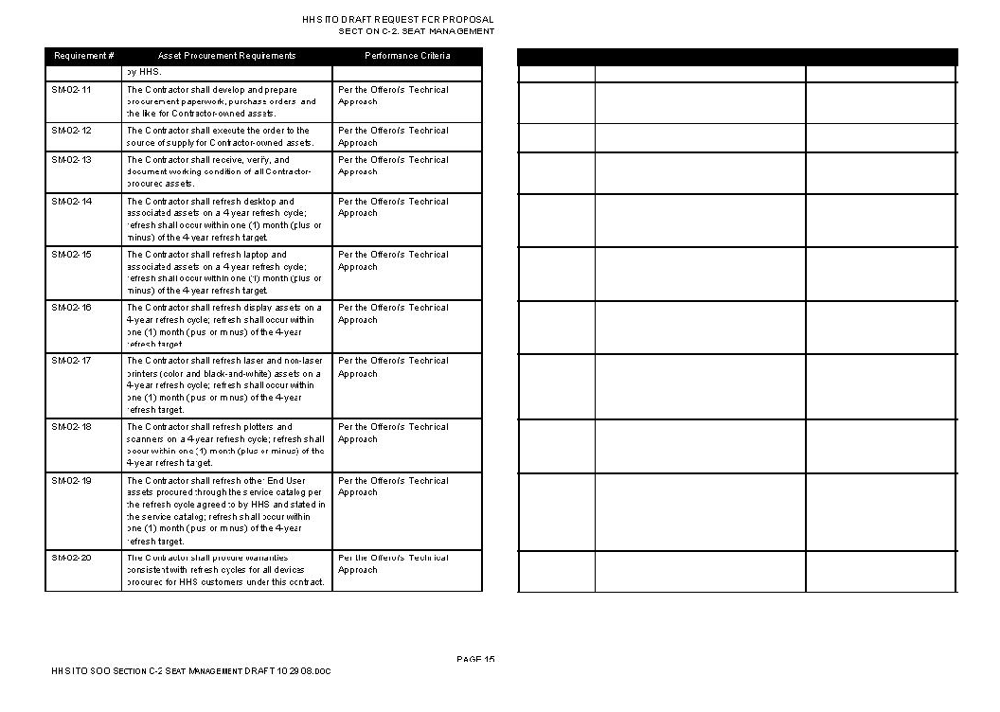

In [8]:
table = cv2.imread("table.jpg")
h, w, _ = table.shape
_, table_thresh = cv2.threshold(table, 127, 255, cv2.THRESH_BINARY)
table_horiz = cv2.morphologyEx(table_thresh, cv2.MORPH_CLOSE, cv2.getStructuringElement(cv2.MORPH_RECT, (10, 1)))
table_horiz = cv2.morphologyEx(table_horiz, cv2.MORPH_OPEN, cv2.getStructuringElement(cv2.MORPH_RECT, (6, 8)))
table_vert = cv2.morphologyEx(table_thresh, cv2.MORPH_CLOSE, cv2.getStructuringElement(cv2.MORPH_RECT, (1, 10)))
table_new = table_horiz & table_vert
show_bgr(np.concatenate((table, table_new), axis=1), size=10)

**7. (5 баллов)** Отделите монеты от фона на изображении $coins\_1.jpg$, отсортируйте монеты по убыванию размера. Сгенерируйте результирующее изображение с цветной разметкой областей, соответствующих монетам на исходном изображении: на черном фоне должны быть выделены разными цветами области, соответствующие монетам. В центре каждой выделенной области разместите порядковый номер монеты в соответствии с сортировкой монет по размеру (в центре области, соответствующей самой большой монете, должно стоять число 1)

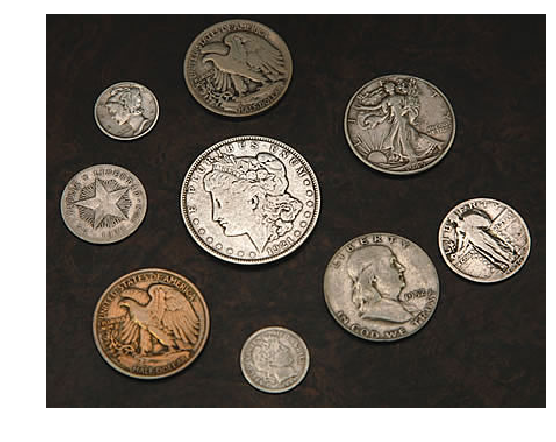

In [9]:
coins = cv2.imread("coins_1.jpg")
show_bgr(coins, size=5)

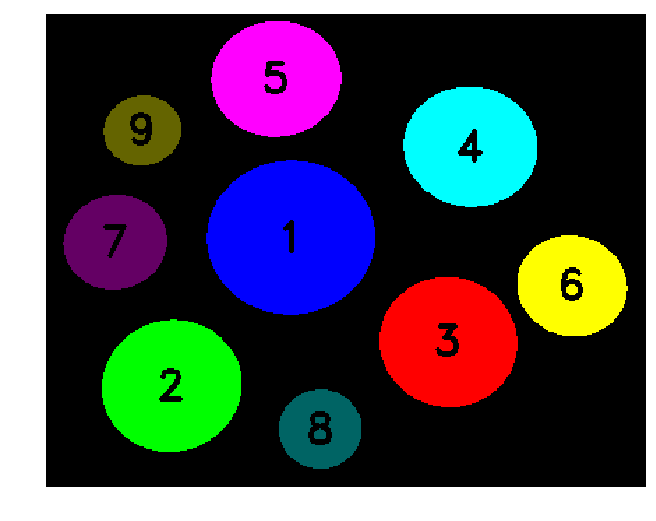

In [11]:
coins_gray = cv2.cvtColor(coins, cv2.COLOR_BGR2GRAY)
coins_thresh = cv2.adaptiveThreshold(coins_gray, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 101, -10)
_, contours, _ = cv2.findContours(coins_thresh, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
contours = sorted([i for i in contours if cv2.contourArea(i) > 2000], key=cv2.contourArea, reverse=True)
coins_new = np.zeros_like(coins)
i = 0
colors = [(255, 0, 0), (0, 255, 0), (0, 0, 255), (255, 255, 0), (255, 0, 255), (0, 255, 255),
          (100, 0, 100), (100, 100, 0), (0, 100, 100)]
for c in contours:
    coin = cv2.fitEllipse(c)
    cv2.ellipse(coins_new, coin, colors[i], -1)
    i += 1
    cv2.putText(coins_new, str(i), (int(coin[0][0]) - 10, int(coin[0][1]) + 10), 2, 1, (0, 0, 0), 2)
show_bgr(coins_new, size=6)

**8. (5 баллов)** Отделите монеты от текста на изображении $coins\_2.jpg.$ Сгенерируйте по входному изображению два изображения: на одном должны остаться только монеты, весь текст должен быть удален; на втором изображении должен остаться только текст, все монеты должны быть удалены.

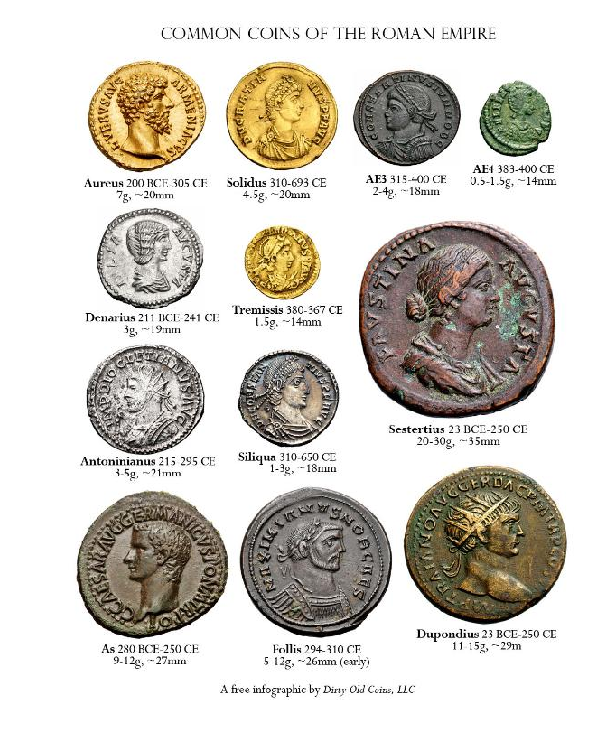

In [13]:
coins = cv2.imread("coins_2.jpg")
show_bgr(coins, size=7)

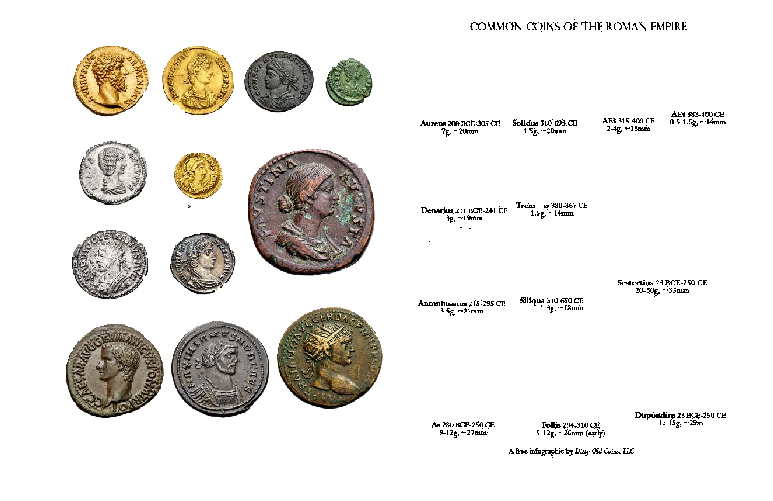

In [15]:
coins_gray = cv2.cvtColor(coins, cv2.COLOR_BGR2GRAY)
coins_thresh = cv2.threshold(coins_gray, 230, 255, cv2.THRESH_BINARY)[1]
coins_shape = cv2.morphologyEx(coins_thresh, cv2.MORPH_CLOSE, cv2.getStructuringElement(cv2.MORPH_RECT, (5, 4)))
coins_shape = cv2.morphologyEx(coins_shape, cv2.MORPH_OPEN, cv2.getStructuringElement(cv2.MORPH_RECT, (15, 18)))
coins_shape = cv2.cvtColor(coins_shape, cv2.COLOR_GRAY2BGR)
coins_1 = coins_shape | (cv2.bitwise_not(coins_shape) & coins)

coins_shape = cv2.bitwise_not(coins_shape)
coins_shape = cv2.dilate(coins_shape, cv2.getStructuringElement(cv2.MORPH_RECT, (10, 10)))
coins_2 = ~((cv2.cvtColor(coins_thresh, cv2.COLOR_GRAY2BGR) & ~coins_shape) ^ ~coins_shape)

show_bgr(np.concatenate((coins_1, coins_2), axis=1), size=7)

### Сравнение глобальных признаков 

Для задач 9 и 10 надо реализовать общую функцию, которая принимет на вход:

* список дескрипторов (**id**, и сам дескриптор) 
* количество максимально похожих для вывода **n**
* функцию сранения дескрипторов

и отдает **n** пар **id** максимально похожих изображений.

**9. (9 баллов)** Посмотрите на изображения в папке *Coral*. Посчитайте гистограммы изображений. Выведите на экран 20 пар изображений с максимально похожими гистограммами. В этом задании надо попробовать:
* различные цветовые пространства (RGB, HSV, CIELab)
* различные способы разбиения на бины (разное количество для каждой характеристики)
* различные метрики сравнения $L_2$, $\chi^2$, пересечение гистограм

In [0]:
import os

def similar_images(inputt, n, compare):
    pics = []
    l = len(inputt)
    for i in range(l):
        for j in range(i + 1, l):
            pics.append((compare(inputt[i][0], inputt[j][0]), (inputt[i][1], inputt[j][1])))
    pics.sort(key=lambda x: x[0])
    return [pair for (comp, pair) in pics[:n]]

def hist(img, bins):
    h = cv2.calcHist([img], [0, 1, 2], None, histSize=[bins, bins, bins], ranges=[0, 256, 0, 256, 0, 256])
    return h[0]

def hi(h1, h2):
    return cv2.compareHist(h1, h2, 1)

def l2(h1, h2):
    return cv2.compareHist(h1, h2, 0)

def resize_height(img1, img2):
    h1, w1, _ = img1.shape
    h2, w2, _ = img2.shape
    if h1 < h2:
        img = np.zeros((h2, w1, 3), dtype=np.uint8)
        img.fill(255)
        img[:h1, :] = img1.copy()
        return img, img2
    elif h1 > h2:
        img = np.zeros((h1, w2, 3), dtype=np.uint8)
        img.fill(255)
        img[:h2, :] = img2.copy()
        return img1, img
    return img1, img2

corals = [cv2.imread(os.path.join('datasets/Corel', file)) for file in os.listdir('datasets/Corel')]

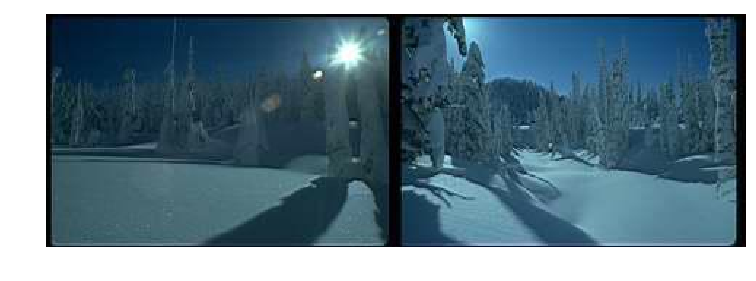

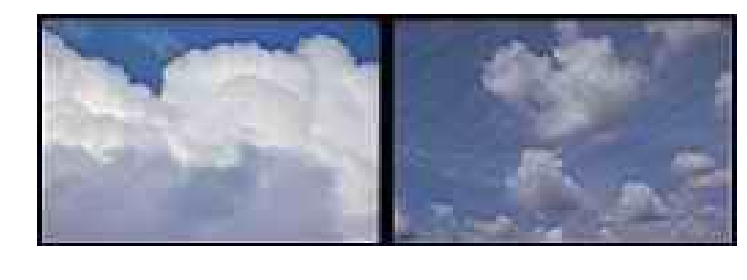

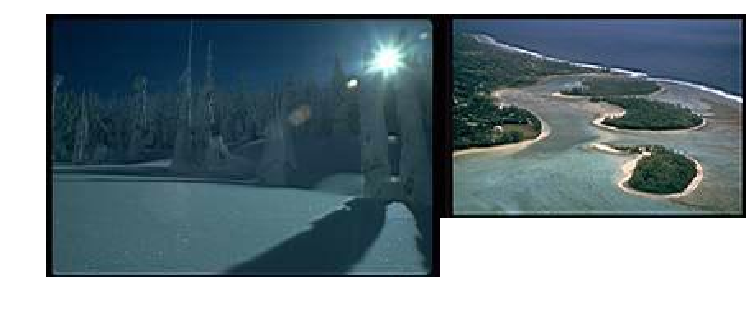

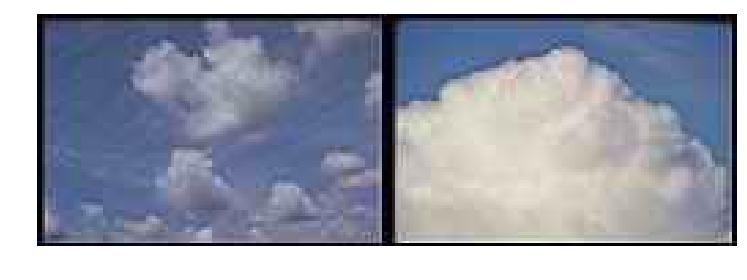

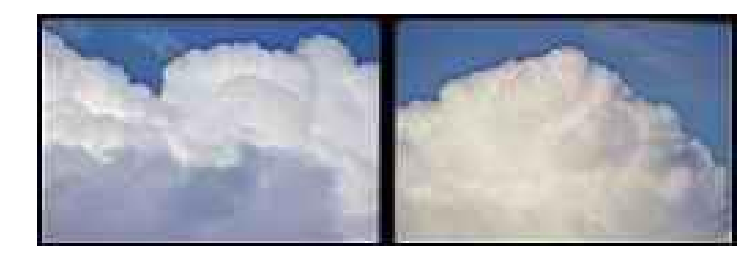

...

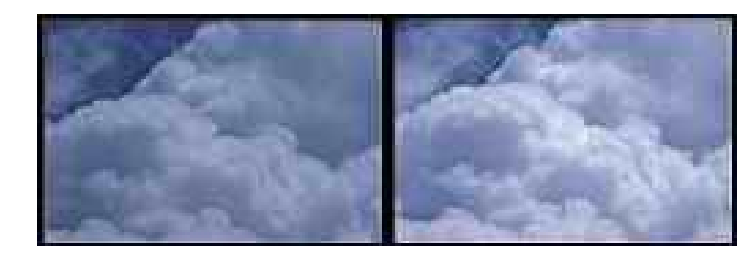

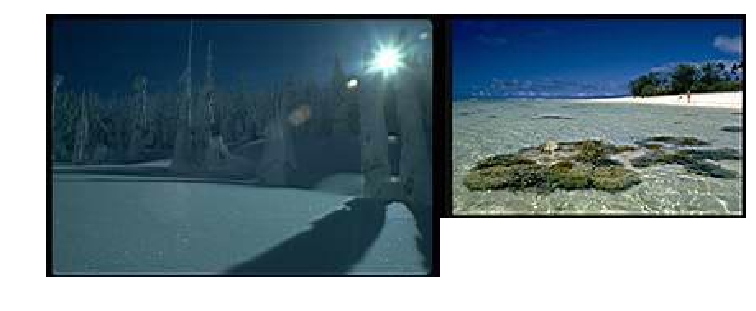

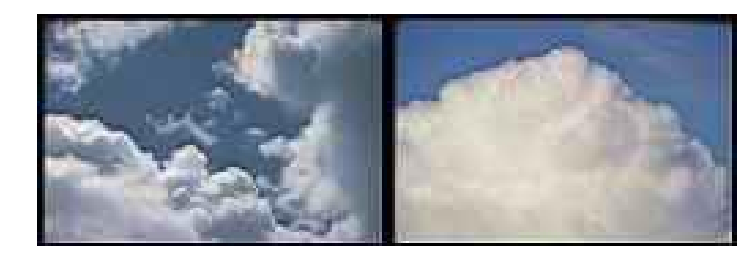

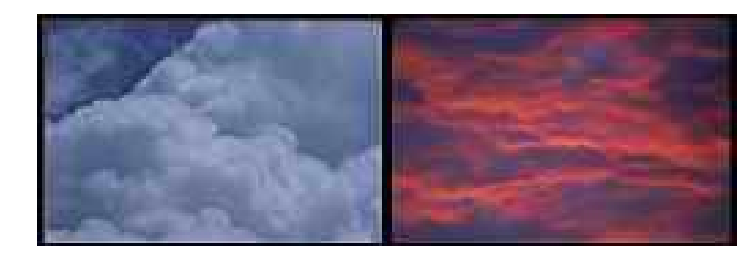

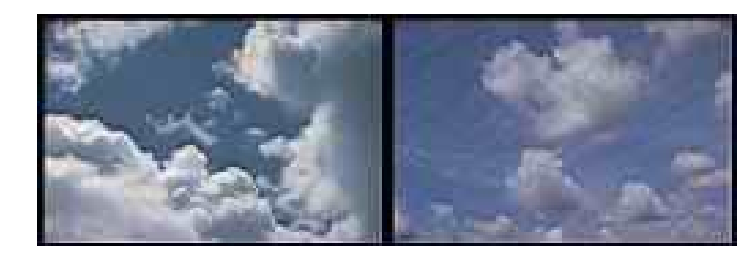

In [18]:
data = [(hist(img, 8), img) for img in corals]
res = similar_images(data, 20, hi)
for pic1, pic2 in res:
    pic1, pic2 = resize_height(pic1.copy(), pic2.copy())
    show_bgr(np.concatenate((pic1, pic2), axis=1), size=7)

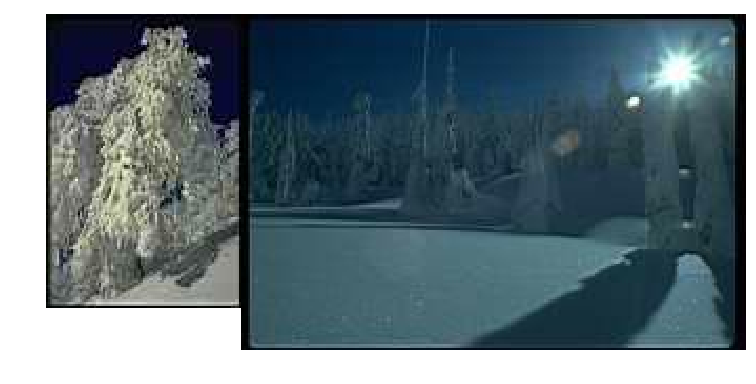

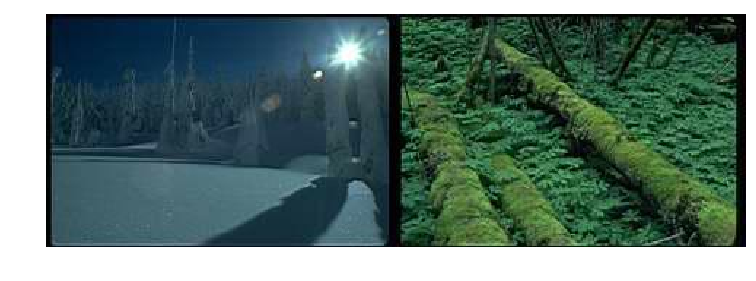

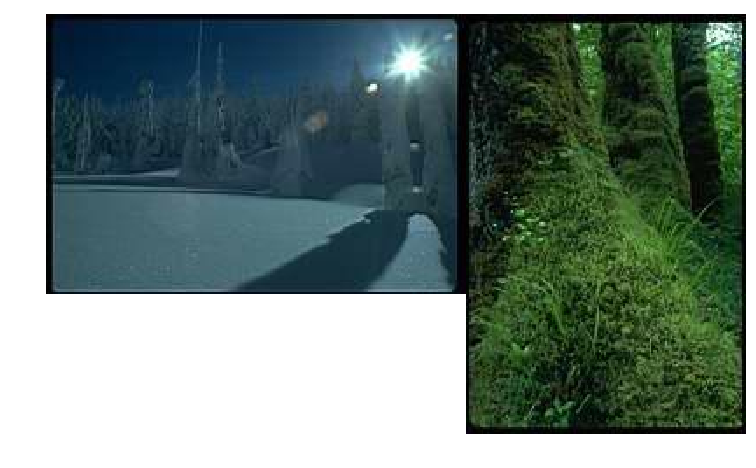

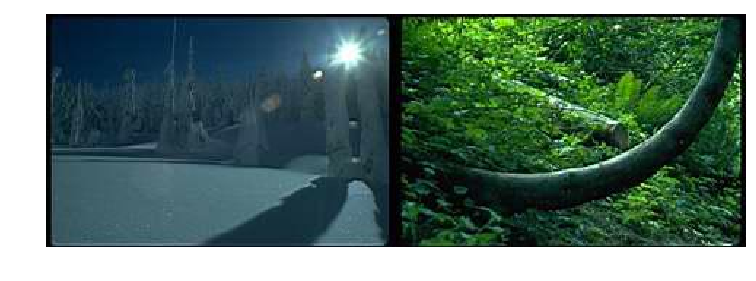

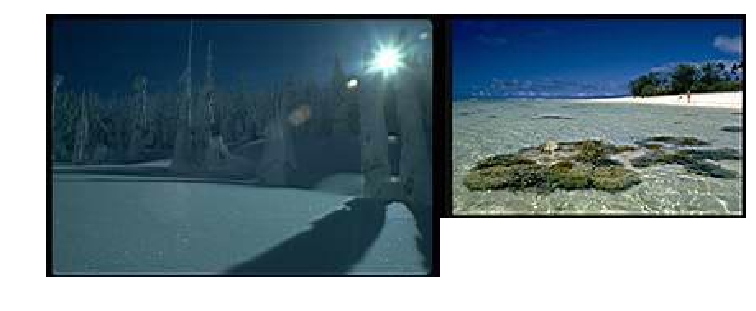

...

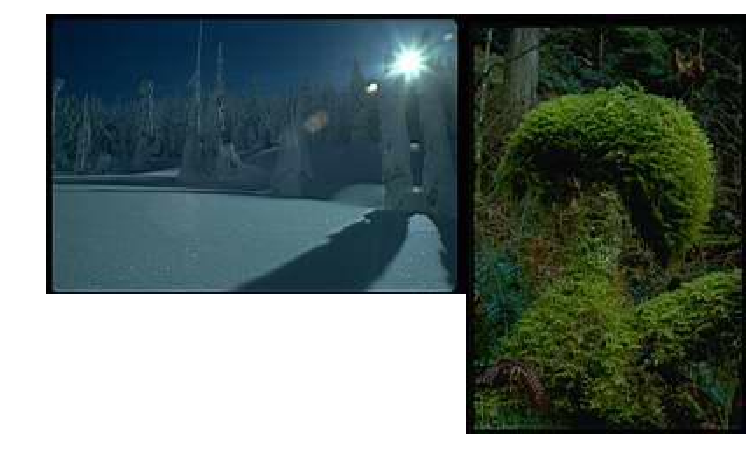

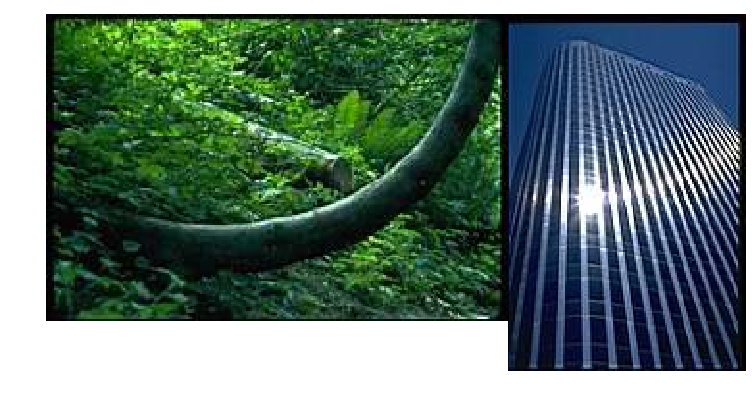

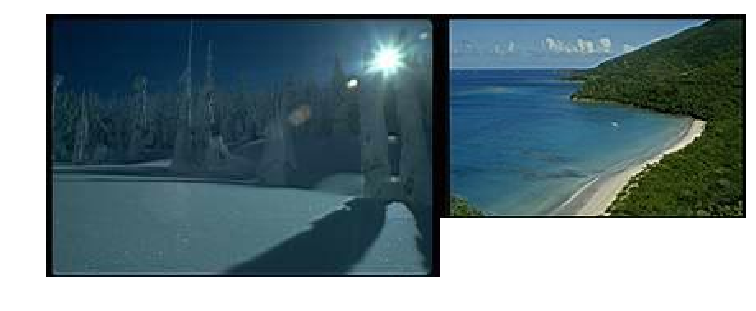

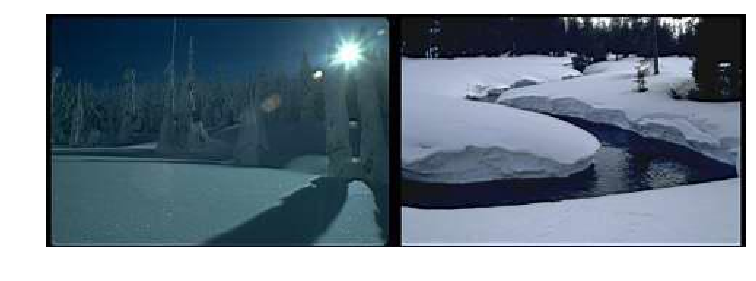

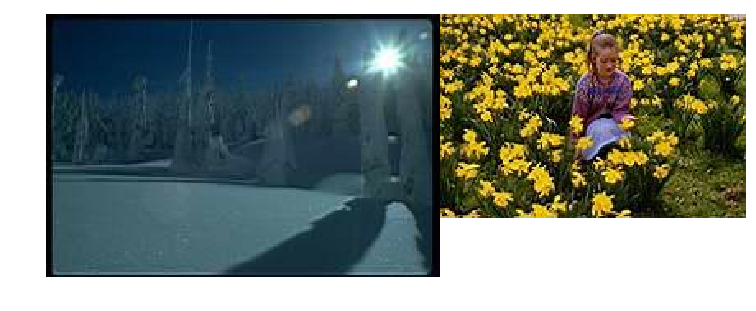

In [19]:
corals_rgb = [cv2.cvtColor(coral, cv2.COLOR_BGR2RGB) for coral in corals]
data = [(hist(img, 10), img) for img in corals_rgb]
res = similar_images(data, 20, l2)
for pic1, pic2 in res:
    pic1 = cv2.cvtColor(pic1, cv2.COLOR_RGB2BGR)
    pic2 = cv2.cvtColor(pic2, cv2.COLOR_RGB2BGR)
    pic1, pic2 = resize_height(pic1.copy(), pic2.copy())
    show_bgr(np.concatenate((pic1, pic2), axis=1), size=7)

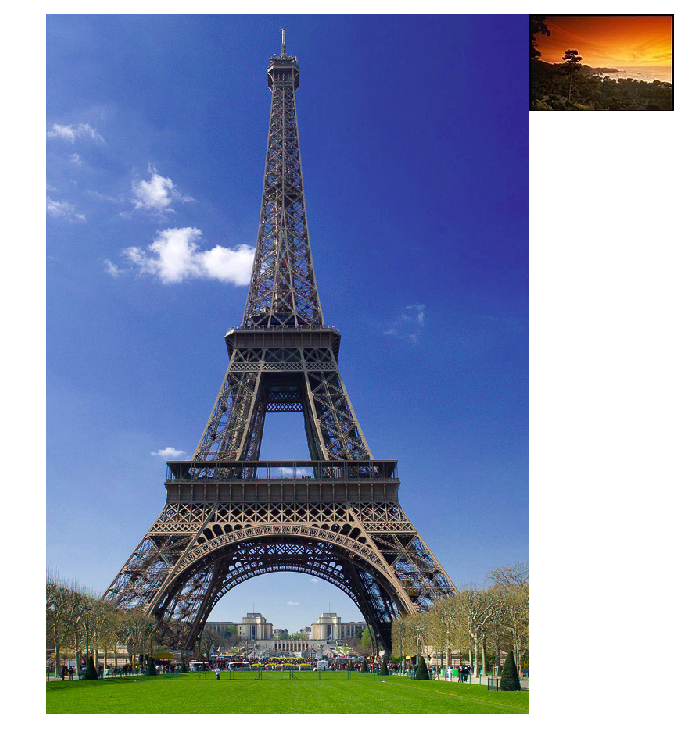

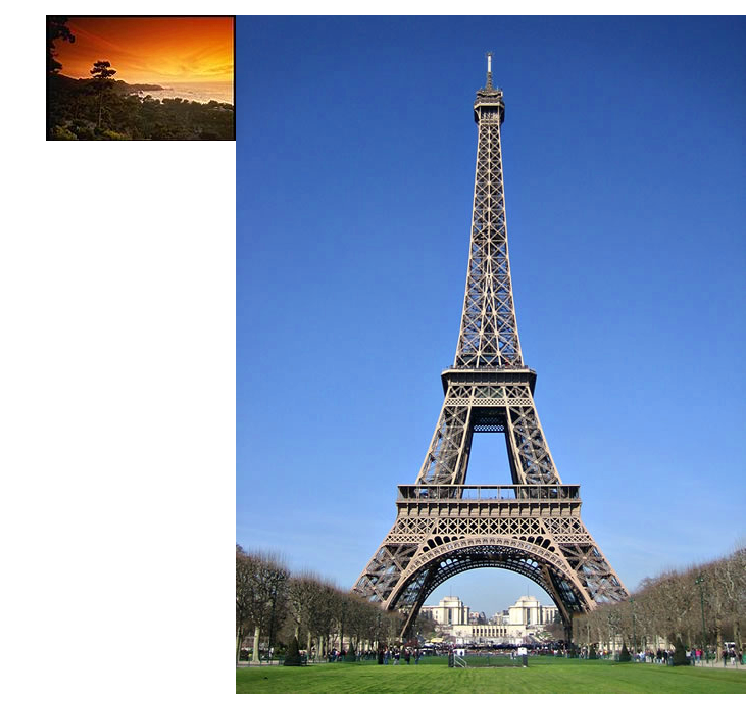

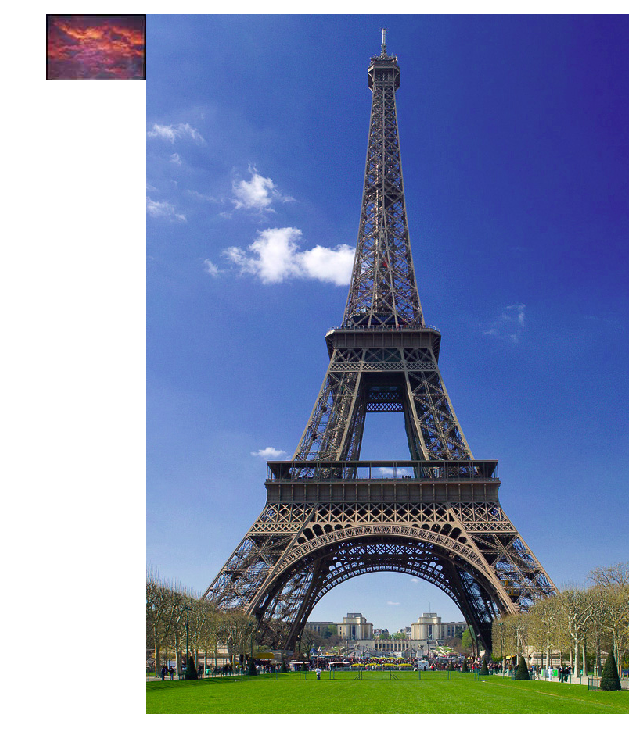

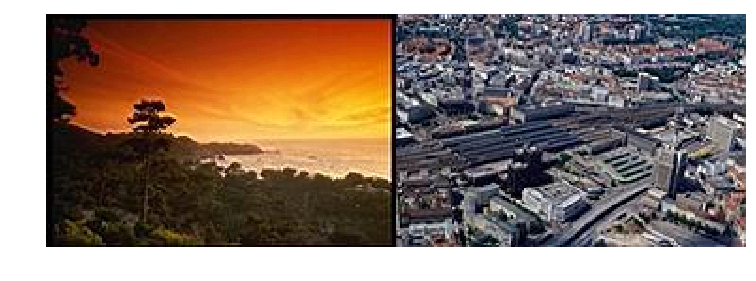

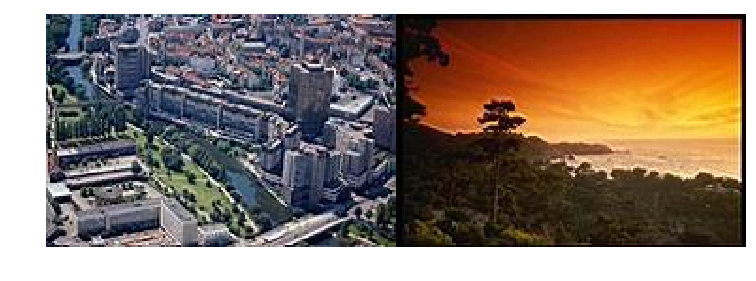

...

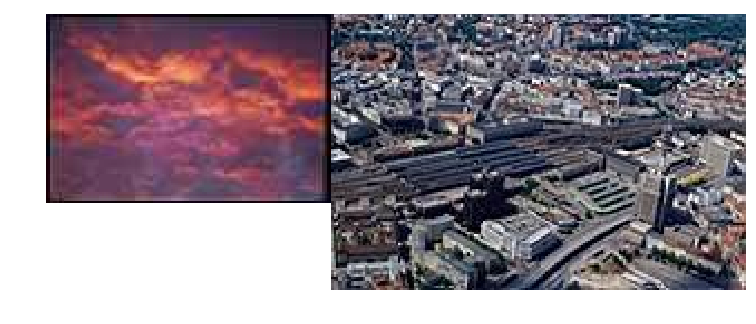

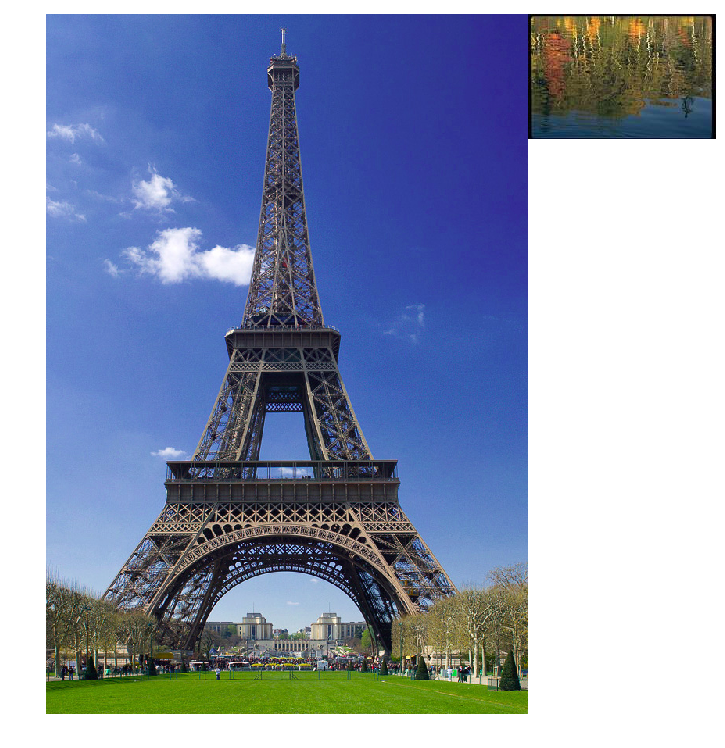

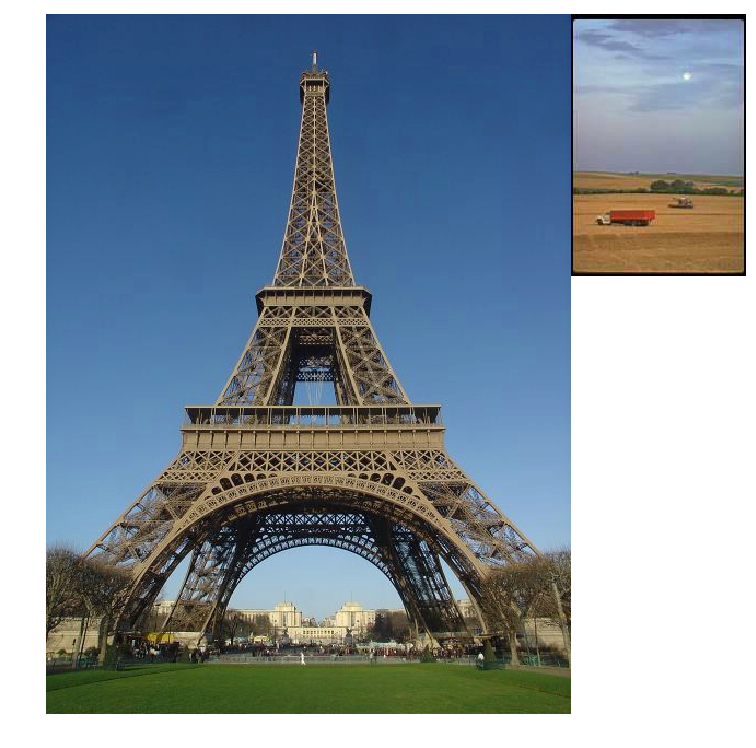

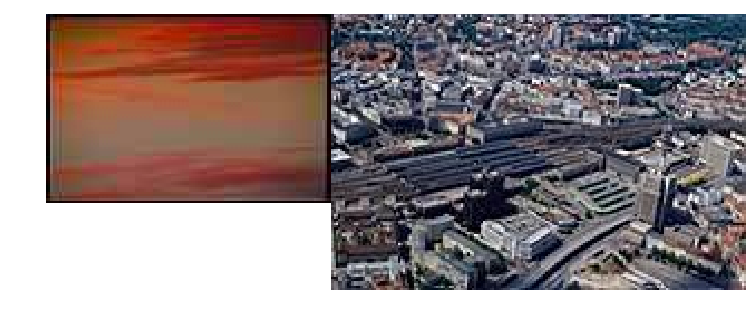

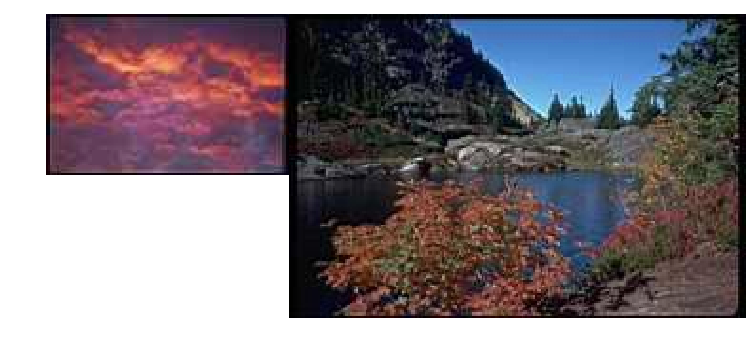

In [20]:
corals_hsv = [cv2.cvtColor(coral, cv2.COLOR_BGR2HSV) for coral in corals]
data = [(hist(img, 15), img) for img in corals_hsv]
res = similar_images(data, 20, l2)
for pic1, pic2 in res:
    pic1 = cv2.cvtColor(pic1, cv2.COLOR_HSV2BGR)
    pic2 = cv2.cvtColor(pic2, cv2.COLOR_HSV2BGR)
    pic1, pic2 = resize_height(pic1.copy(), pic2.copy())
    show_bgr(np.concatenate((pic1, pic2), axis=1), size=7)

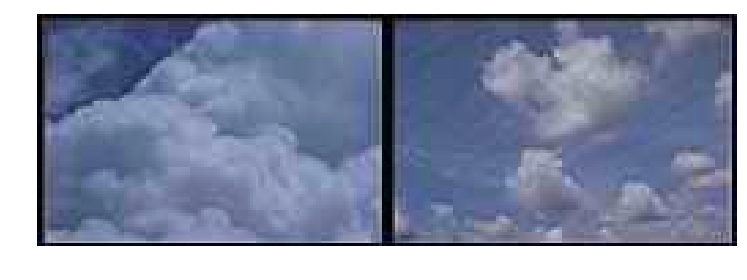

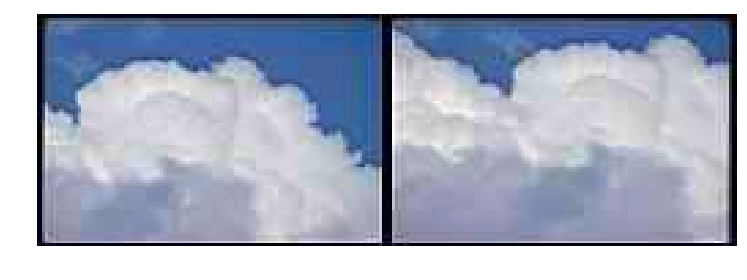

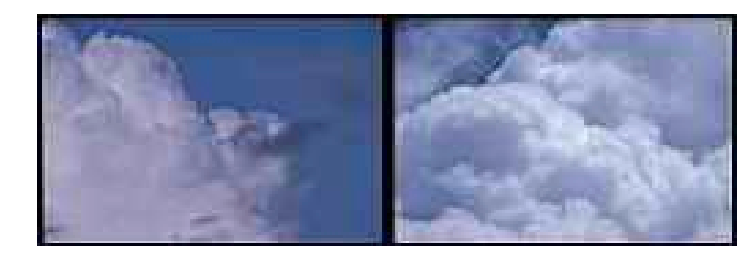

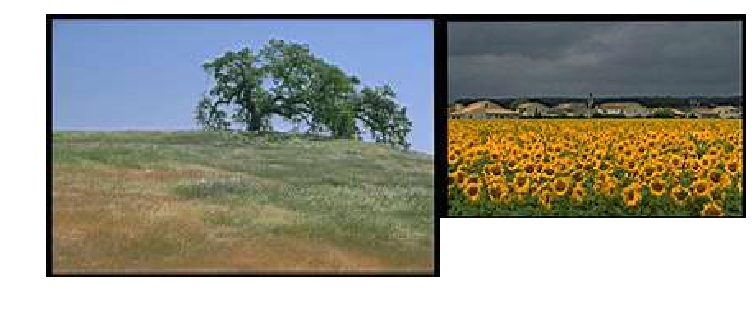

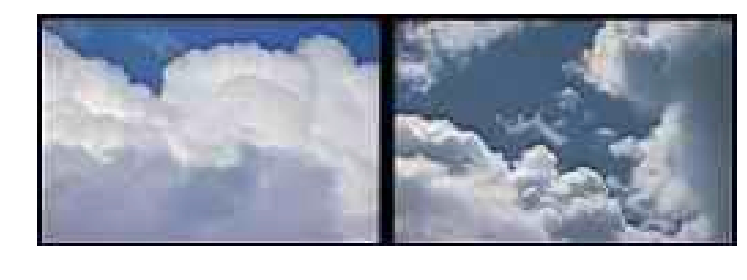

...

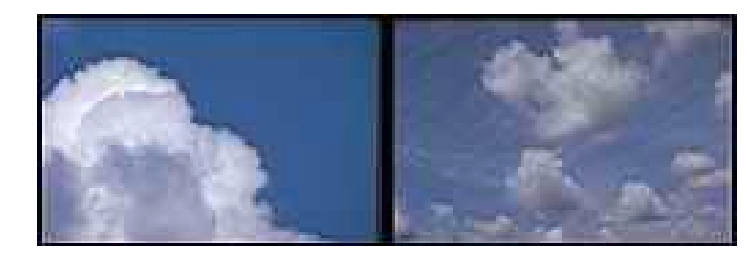

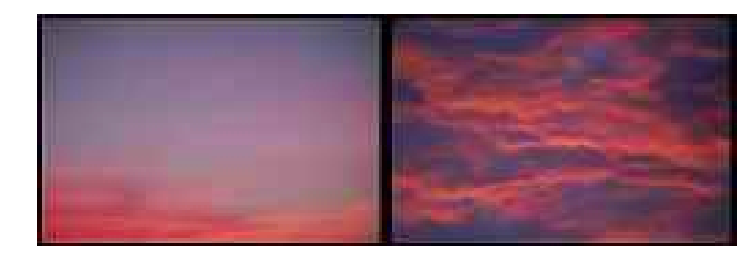

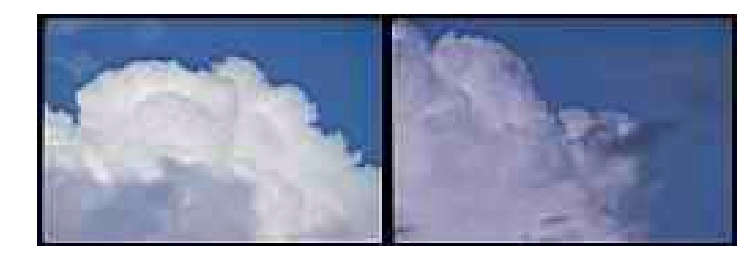

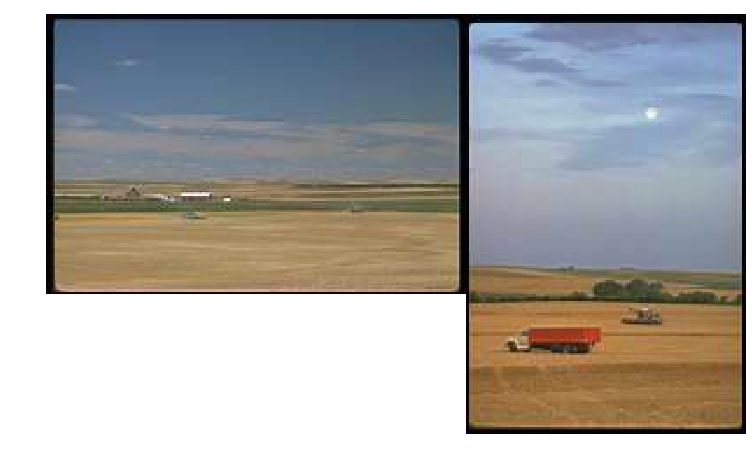

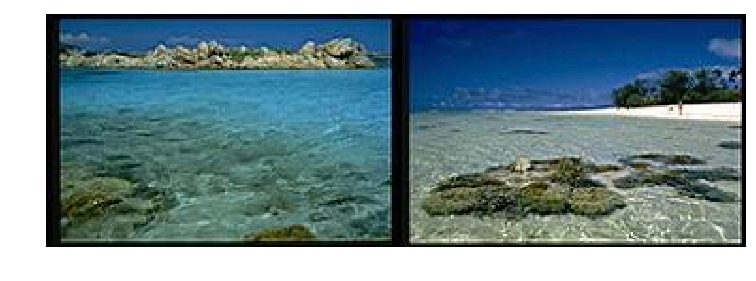

In [21]:
corals_lab = [cv2.cvtColor(coral, cv2.COLOR_BGR2LAB) for coral in corals]
data = [(hist(img, 10), img) for img in corals_lab]
res = similar_images(data, 20, hi)
for pic1, pic2 in res:
    pic1 = cv2.cvtColor(pic1, cv2.COLOR_LAB2BGR)
    pic2 = cv2.cvtColor(pic2, cv2.COLOR_LAB2BGR)
    pic1, pic2 = resize_height(pic1.copy(), pic2.copy())
    show_bgr(np.concatenate((pic1, pic2), axis=1), size=7)

**10. (10 баллов)** Посмотрите на изображения в папке *leaves*. Посчитайте дескрипторы Фурье для каждого листочка изображений. Выведите на экран 20 пар изображений с максимально похожими дескрипторами.

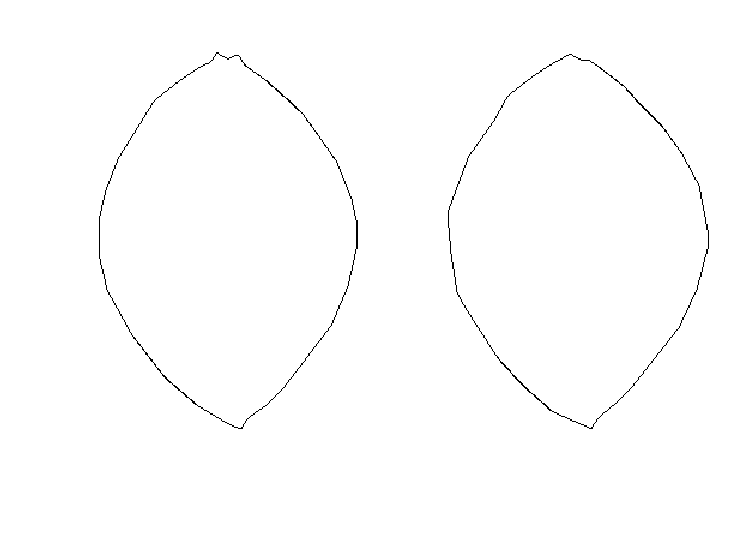

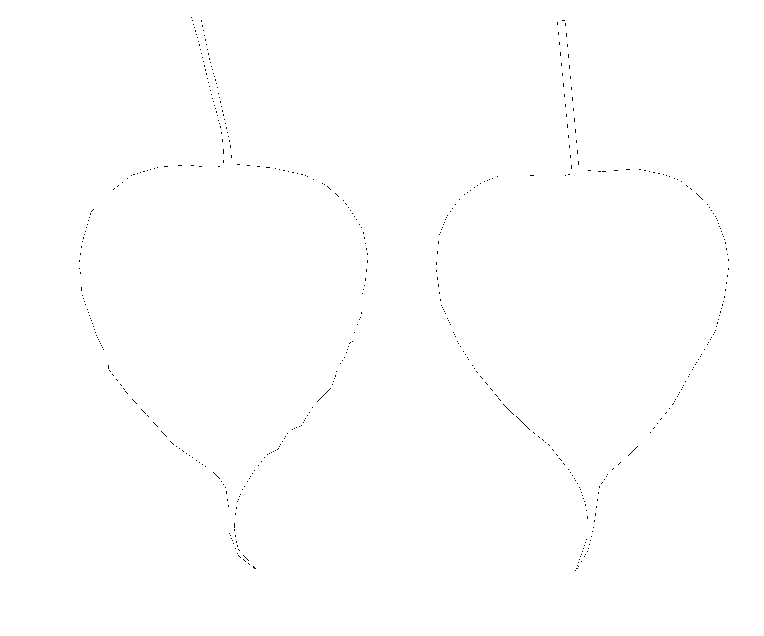

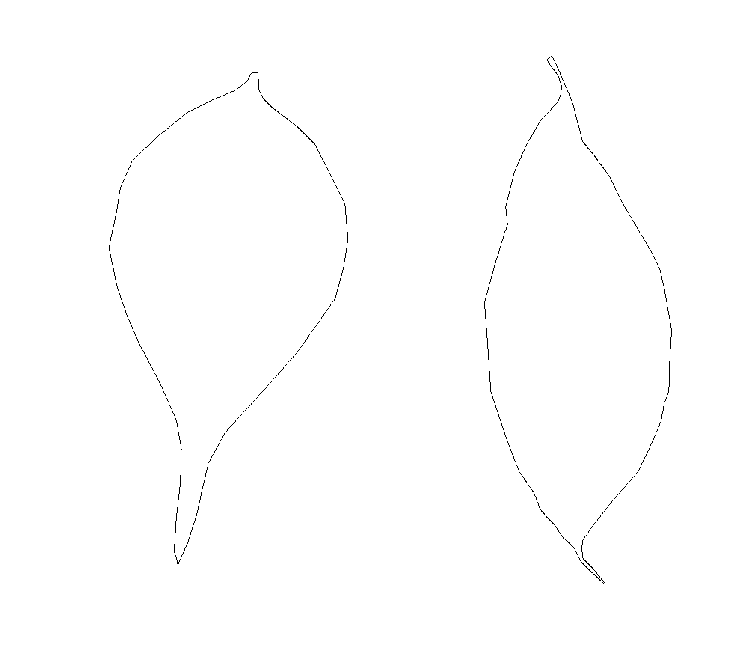

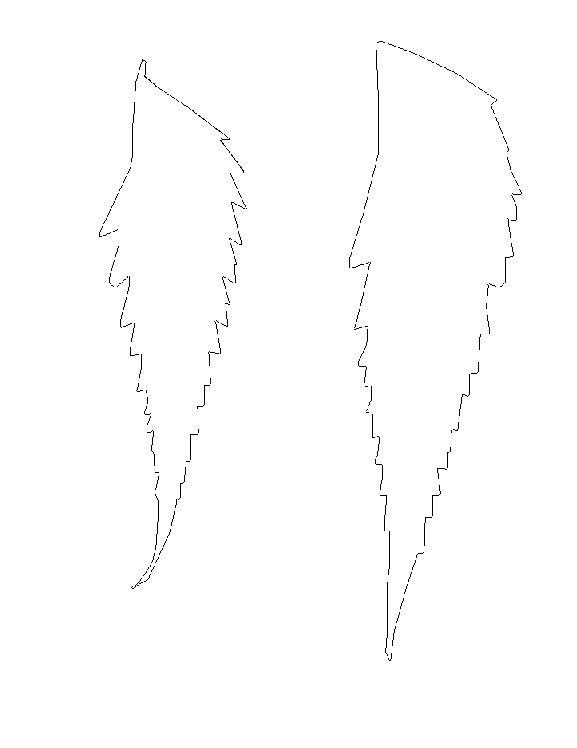

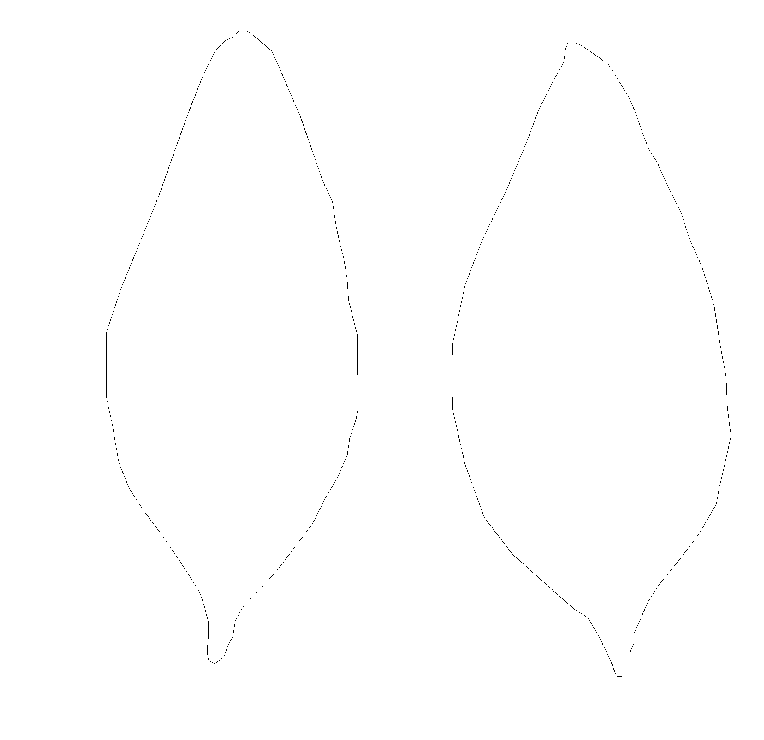

...

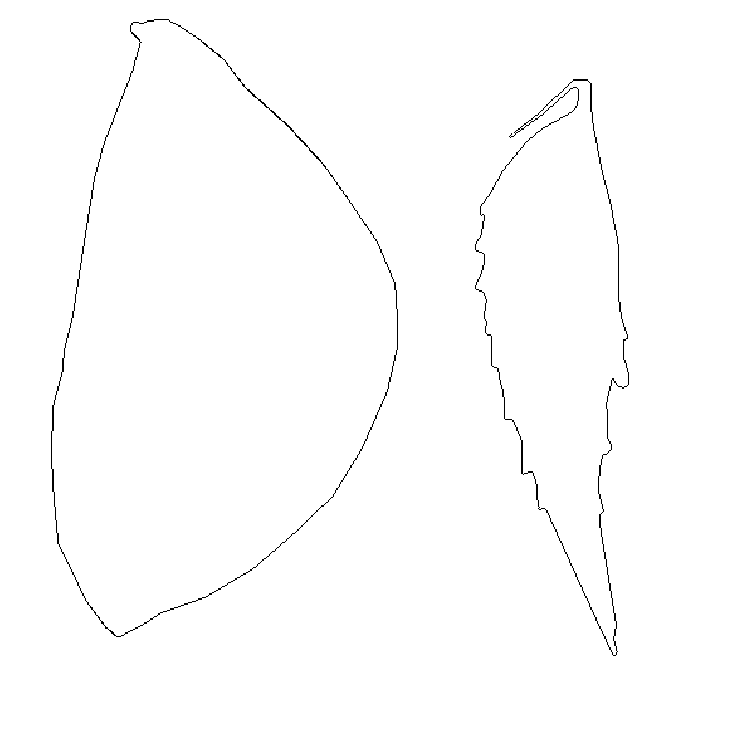

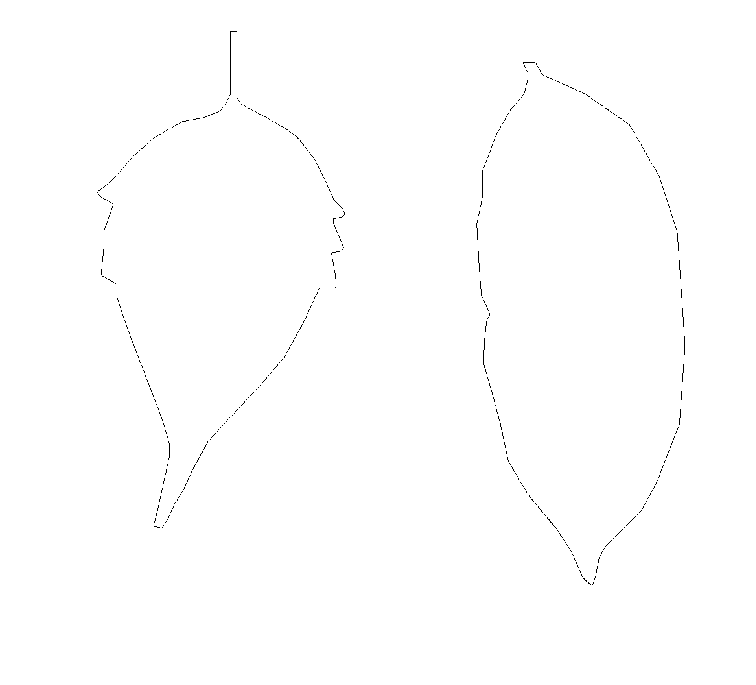

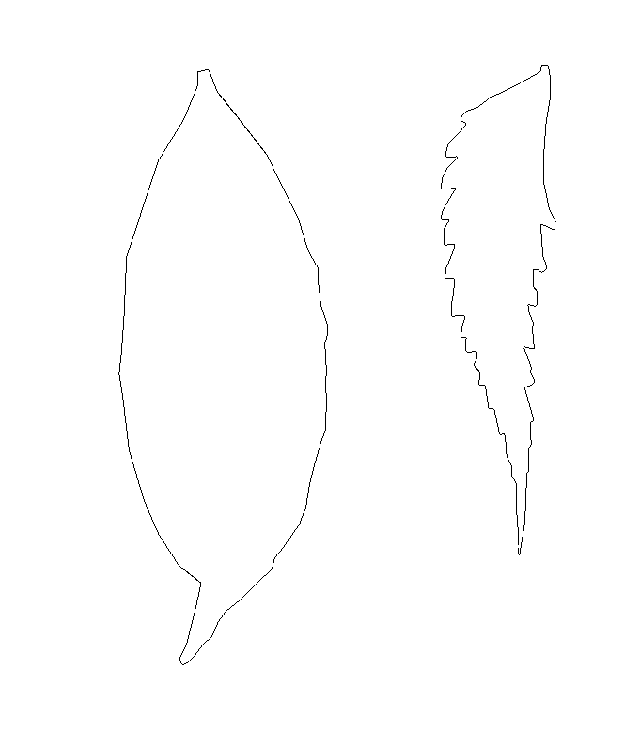

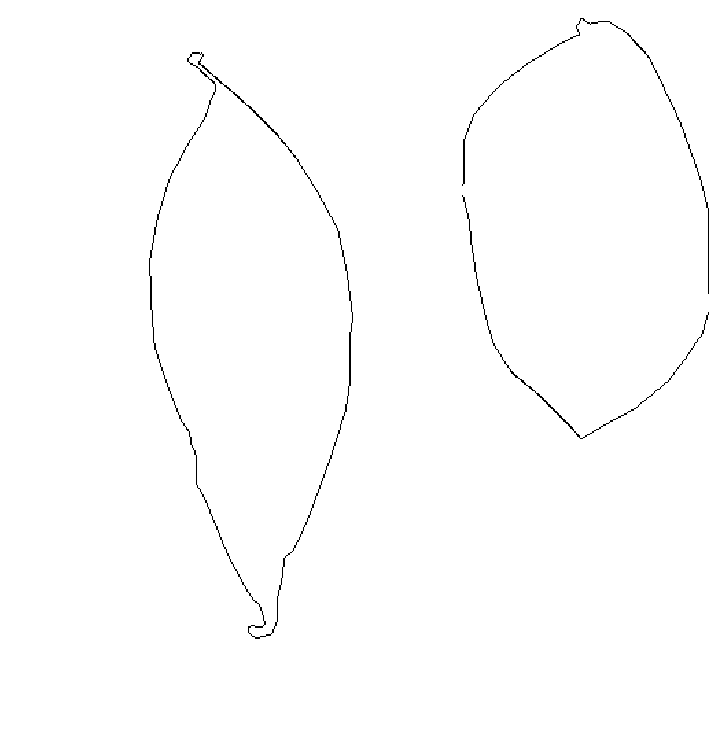

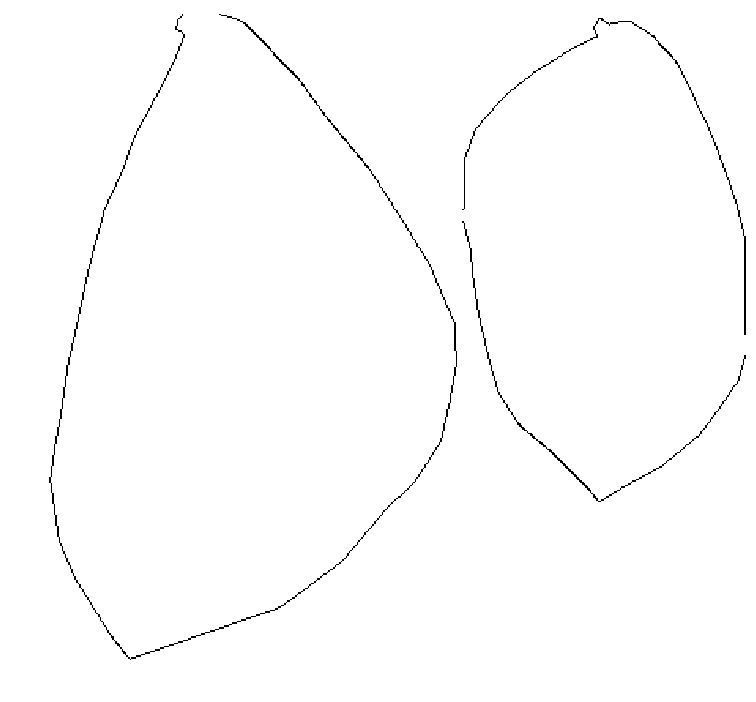

In [22]:
def fourier_desc(img):
    _, img = cv2.threshold(cv2.cvtColor(img, cv2.COLOR_BGR2GRAY), 127, 255, cv2.THRESH_BINARY_INV)
    _, contours, _ = cv2.findContours(img, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)
    return cv2.ximgproc.fourierDescriptor(contours[0].astype(np.float32))

def compare_desc(d1, d2):
    n = min(len(d1), len(d2))
    return np.sum(np.abs((d1[:n] - d2[:n]) ** 2))

leaves = [cv2.imread(os.path.join('datasets/leaves', file)) for file in os.listdir('datasets/leaves')]
leaves_w_descs = [(fourier_desc(leave), leave) for leave in leaves]
res = similar_images(leaves_w_descs, 20, compare_desc)
for pic1, pic2 in res:
    pic1, pic2 = resize_height(pic1.copy(), pic2.copy())
    show_bgr(np.concatenate((pic1, pic2), axis=1), size=7)